In [1]:
import illustris_python as il
import mistree as mist
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import astropy.units as u
import astropy.constants as c
import pandas as pd
import networkx as nx
import seaborn as sns
import scienceplots

from sklearn.neighbors import radius_neighbors_graph
from scipy.spatial import Delaunay
from scipy.spatial.distance import euclidean, minkowski
from sklearn.preprocessing import PowerTransformer

import Utilities as ut

plt.style.use(['science','no-latex'])

In [2]:
testcat = ut.cat(path=r'/Users/daksheshkololgi/Library/CloudStorage/OneDrive-UniversityCollegeLondon/Year 1/Illustris/TNG300-1', snapno=99, masscut=1e10)

There are 97233 subhalos with stellar mass greater than 0.6774.


In [3]:
testcat.object['subhalos'].keys()

dict_keys(['count', 'SubhaloBHMass', 'SubhaloBHMdot', 'SubhaloBfldDisk', 'SubhaloBfldHalo', 'SubhaloCM', 'SubhaloFlag', 'SubhaloGasMetalFractions', 'SubhaloGasMetalFractionsHalfRad', 'SubhaloGasMetalFractionsMaxRad', 'SubhaloGasMetalFractionsSfr', 'SubhaloGasMetalFractionsSfrWeighted', 'SubhaloGasMetallicity', 'SubhaloGasMetallicityHalfRad', 'SubhaloGasMetallicityMaxRad', 'SubhaloGasMetallicitySfr', 'SubhaloGasMetallicitySfrWeighted', 'SubhaloGrNr', 'SubhaloHalfmassRad', 'SubhaloHalfmassRadType', 'SubhaloIDMostbound', 'SubhaloLen', 'SubhaloLenType', 'SubhaloMass', 'SubhaloMassInHalfRad', 'SubhaloMassInHalfRadType', 'SubhaloMassInMaxRad', 'SubhaloMassInMaxRadType', 'SubhaloMassInRad', 'SubhaloMassInRadType', 'SubhaloMassType', 'SubhaloParent', 'SubhaloPos', 'SubhaloSFR', 'SubhaloSFRinHalfRad', 'SubhaloSFRinMaxRad', 'SubhaloSFRinRad', 'SubhaloSpin', 'SubhaloStarMetalFractions', 'SubhaloStarMetalFractionsHalfRad', 'SubhaloStarMetalFractionsMaxRad', 'SubhaloStarMetallicity', 'SubhaloStarMe

In [4]:
stars = (testcat.object['subhalos']['SubhaloMassType'][:,4]) #stellar mass of subhalos
mc = testcat.masscut*testcat.hub/1e10 #mass cut for subhalos
stars_indices = np.where(stars>=mc)[0] #indices of subhalos with stellar mass greater than masscut

In [5]:
np.shape(testcat.object['subhalos']['SubhaloStellarPhotometrics'][stars_indices])

(97233, 8)

In [6]:
magnitudes = testcat.object['subhalos']['SubhaloStellarPhotometrics'][stars_indices]

In [7]:
# U, B, V, K, g, r, i, z

U, B, V, K, g, r, i, z = magnitudes.T

# U-B, B-V, V-K, g-r, r-i, i-z
UB = U-B
BV = B-V
VK = V-K
gr = g-r
ri = r-i
iz = i-z



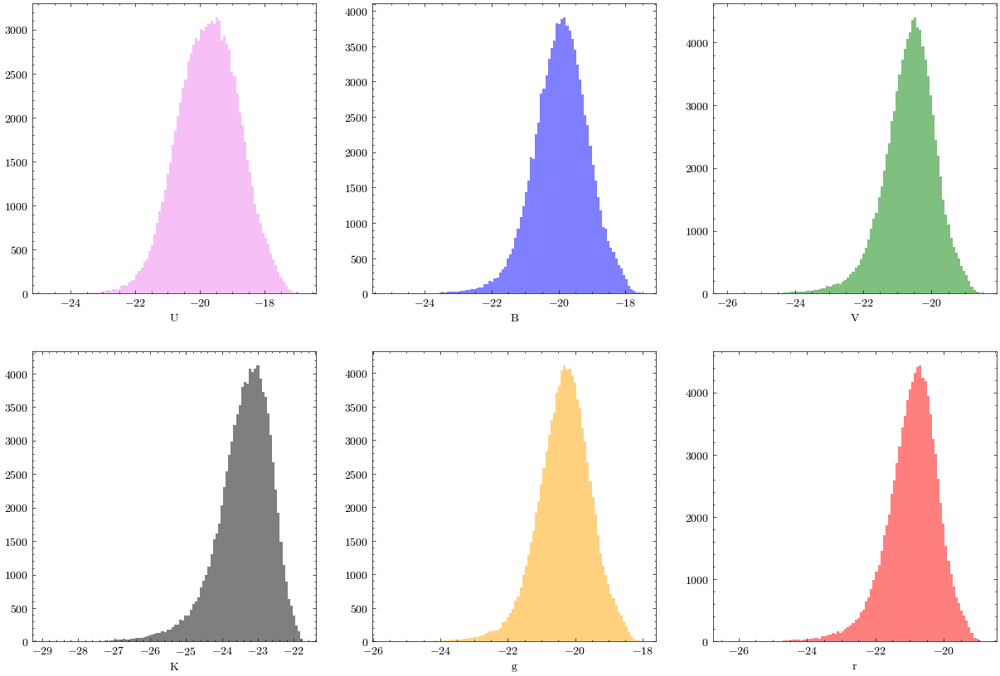

In [8]:
# histograms of luminosities
fig, ax = plt.subplots(2,3, figsize=(15,10))
ax[0,0].hist(U, bins=100, color='violet', alpha=0.5, label='U')
ax[0,1].hist(B, bins=100, color='blue', alpha=0.5, label='B')
ax[0,2].hist(V, bins=100, color='green', alpha=0.5, label='V')
ax[1,0].hist(K, bins=100, color='black', alpha=0.5, label='K')
ax[1,1].hist(g, bins=100, color='orange', alpha=0.5, label='g')
ax[1,2].hist(r, bins=100, color='red', alpha=0.5, label='r')
ax[0,0].set_xlabel('U')
ax[0,1].set_xlabel('B')
ax[0,2].set_xlabel('V')
ax[1,0].set_xlabel('K')
ax[1,1].set_xlabel('g')
ax[1,2].set_xlabel('r')
plt.show()



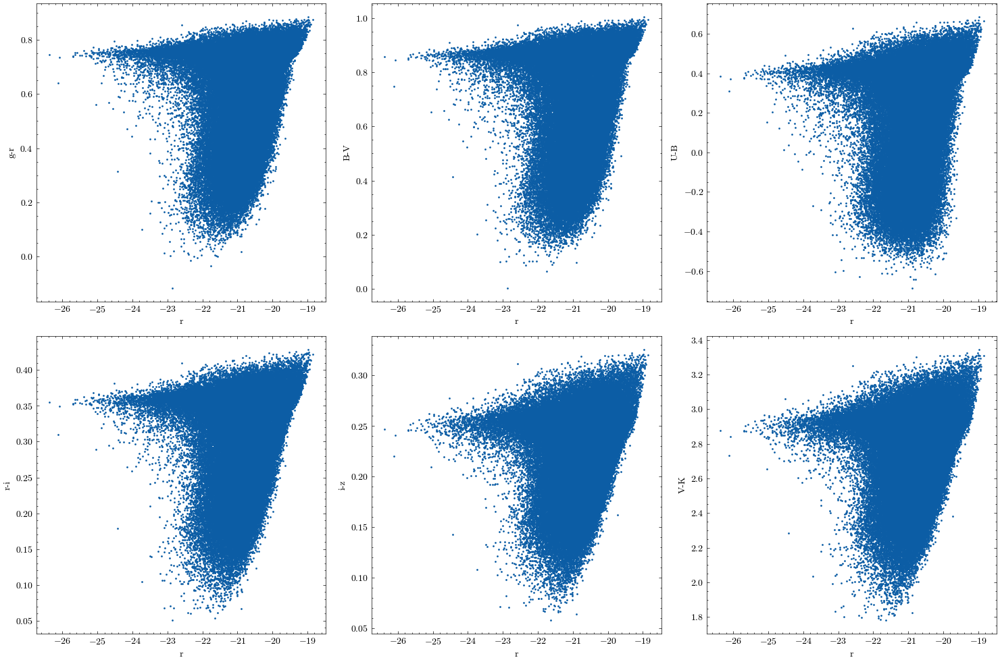

In [9]:
fig, ax = plt.subplots(2,3, figsize=(15,10))
ax[0,0].scatter(r, gr, s=1)
ax[0,0].set_xlabel('r')
ax[0,0].set_ylabel('g-r')
ax[0,1].scatter(r, BV, s=1)
ax[0,1].set_xlabel('r')
ax[0,1].set_ylabel('B-V')
ax[0,2].scatter(r, UB, s=1)
ax[0,2].set_xlabel('r')
ax[0,2].set_ylabel('U-B')
ax[1,0].scatter(r, ri, s=1)
ax[1,0].set_xlabel('r')
ax[1,0].set_ylabel('r-i')
ax[1,1].scatter(r, iz, s=1)
ax[1,1].set_xlabel('r')
ax[1,1].set_ylabel('i-z')
ax[1,2].scatter(r, VK, s=1)
ax[1,2].set_xlabel('r')
ax[1,2].set_ylabel('V-K')

plt.tight_layout()
plt.show()


In [10]:
data = pd.read_csv('data_delaunay2.csv', index_col=0)

In [11]:
data

,Degree,Mean E.L.,Max E.L.,Clustering,Density,Neigh Density,Target,x,y,z
0,3.786575,0.252438,0.610647,0.000323,185.880269,175.964597,3.0,64.539150,72.060295,217.88449
1,3.439105,0.245650,0.353270,0.000354,231.832891,282.636896,3.0,67.083374,76.542960,216.14484
2,4.289986,0.428999,0.740822,0.000867,34.527336,41.029794,3.0,65.678720,72.470800,218.29138
3,5.261107,0.751587,1.320098,0.001769,3.062777,1.367740,3.0,64.689680,75.198410,218.05590
4,9.891149,0.760858,1.141795,0.001110,4.098506,5.143066,3.0,65.400920,73.266860,218.28978
...,...,...,...,...,...,...,...,...,...,...
97228,81.350501,3.697750,11.299435,0.003283,0.003181,0.272363,3.0,15.100064,175.660930,284.90670
97229,74.863507,4.990900,18.656740,0.006422,0.000498,0.844022,2.0,260.862520,159.709170,275.62158
97230,40.762152,2.397774,3.451464,0.002639,0.033671,0.064352,2.0,65.984116,69.660920,221.26585
97231,51.334932,3.019702,6.863998,0.003514,0.008619,0.080914,2.0,64.463700,109.076010,218.45459


In [13]:
# Add colours to the data as coloumns
data.insert(0, 'UB', UB)
data.insert(0, 'BV', BV)
data.insert(0, 'VK', VK)
data.insert(0, 'gr', gr)
data.insert(0, 'ri', ri)
data.insert(0, 'iz', iz)

data

,iz,ri,gr,VK,BV,UB,Degree,Mean E.L.,Max E.L.,Clustering,Density,Neigh Density,Target,x,y,z
0,0.246576,0.355204,0.744980,2.877186,0.856562,0.386292,3.786575,0.252438,0.610647,0.000323,185.880269,175.964597,3.0,64.539150,72.060295,217.88449
1,0.246273,0.354000,0.744604,2.874083,0.858065,0.392696,3.439105,0.245650,0.353270,0.000354,231.832891,282.636896,3.0,67.083374,76.542960,216.14484
2,0.277588,0.380924,0.796059,3.051720,0.913361,0.495522,4.289986,0.428999,0.740822,0.000867,34.527336,41.029794,3.0,65.678720,72.470800,218.29138
3,0.265276,0.371439,0.776884,2.982134,0.893255,0.457644,5.261107,0.751587,1.320098,0.001769,3.062777,1.367740,3.0,64.689680,75.198410,218.05590
4,0.266430,0.370907,0.778084,2.986029,0.894632,0.460569,9.891149,0.760858,1.141795,0.001110,4.098506,5.143066,3.0,65.400920,73.266860,218.28978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97228,0.272301,0.379166,0.789824,3.025105,0.907541,0.485970,81.350501,3.697750,11.299435,0.003283,0.003181,0.272363,3.0,15.100064,175.660930,284.90670
97229,0.242338,0.341352,0.726097,2.869801,0.843563,0.387224,74.863507,4.990900,18.656740,0.006422,0.000498,0.844022,2.0,260.862520,159.709170,275.62158
97230,0.247278,0.358326,0.752422,2.881067,0.867168,0.408779,40.762152,2.397774,3.451464,0.002639,0.033671,0.064352,2.0,65.984116,69.660920,221.26585
97231,0.266560,0.370604,0.779337,2.987701,0.897524,0.468882,51.334932,3.019702,6.863998,0.003514,0.008619,0.080914,2.0,64.463700,109.076010,218.45459


In [14]:
len(UB[UB<0])

26340

In [18]:
buffered_indices = np.where((data['x']>10) & (data['x']<290) & (data['y']>10) & (data['y']<290) & (data['z']>10) & (data['z']<290))[0]

In [19]:
data = data.iloc[buffered_indices]

In [20]:
data.drop(columns=['x', 'y', 'z'], inplace=True)

In [21]:
data

,iz,ri,gr,VK,BV,UB,Degree,Mean E.L.,Max E.L.,Clustering,Density,Neigh Density,Target
0,0.246576,0.355204,0.744980,2.877186,0.856562,0.386292,3.786575,0.252438,0.610647,0.000323,185.880269,175.964597,3.0
1,0.246273,0.354000,0.744604,2.874083,0.858065,0.392696,3.439105,0.245650,0.353270,0.000354,231.832891,282.636896,3.0
2,0.277588,0.380924,0.796059,3.051720,0.913361,0.495522,4.289986,0.428999,0.740822,0.000867,34.527336,41.029794,3.0
3,0.265276,0.371439,0.776884,2.982134,0.893255,0.457644,5.261107,0.751587,1.320098,0.001769,3.062777,1.367740,3.0
4,0.266430,0.370907,0.778084,2.986029,0.894632,0.460569,9.891149,0.760858,1.141795,0.001110,4.098506,5.143066,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
97228,0.272301,0.379166,0.789824,3.025105,0.907541,0.485970,81.350501,3.697750,11.299435,0.003283,0.003181,0.272363,3.0
97229,0.242338,0.341352,0.726097,2.869801,0.843563,0.387224,74.863507,4.990900,18.656740,0.006422,0.000498,0.844022,2.0
97230,0.247278,0.358326,0.752422,2.881067,0.867168,0.408779,40.762152,2.397774,3.451464,0.002639,0.033671,0.064352,2.0
97231,0.266560,0.370604,0.779337,2.987701,0.897524,0.468882,51.334932,3.019702,6.863998,0.003514,0.008619,0.080914,2.0


In [22]:
features = data.iloc[:,:-1] # All columns except the last one
targets = data.iloc[:,-1] # The last column

scaler = PowerTransformer()
# scaler = PowerTransformer(method = 'box-cox')
features = pd.DataFrame(scaler.fit_transform(features), index=features.index, columns=features.columns)

In [23]:
features

,iz,ri,gr,VK,BV,UB,Degree,Mean E.L.,Max E.L.,Clustering,Density,Neigh Density
0,0.435376,0.757678,0.792429,0.391285,0.769160,0.610922,-1.953958,-1.958494,-1.992232,-1.957555,2.735827,2.211869
1,0.426608,0.732292,0.789348,0.375784,0.780351,0.644924,-1.990737,-1.962716,-2.064199,-1.947881,2.735827,2.212047
2,1.436320,1.342655,1.234717,1.368229,1.214847,1.233334,-1.904101,-1.852717,-1.957250,-1.787453,2.735726,2.208233
3,1.013226,1.117217,1.063134,0.953057,1.051647,1.007115,-1.817274,-1.676260,-1.810664,-1.511915,2.681015,1.594363
4,1.051385,1.104914,1.073671,0.975363,1.062631,1.024190,-1.505643,-1.671459,-1.854386,-1.712560,2.707466,2.096402
...,...,...,...,...,...,...,...,...,...,...,...,...
97228,1.250263,1.299969,1.178173,1.205215,1.166983,1.175225,0.067670,-0.540785,-0.068501,-1.065915,-0.436994,0.373144
97229,0.314511,0.475602,0.640607,0.354496,0.673705,0.615855,-0.012348,-0.171917,0.896007,-0.204111,-0.461744,1.253786
97230,0.455740,0.824334,0.853962,0.410760,0.848819,0.731646,-0.548765,-0.972025,-1.350056,-1.253203,-0.172992,-0.304068
97231,1.055693,1.097919,1.084704,0.984976,1.085789,1.073062,-0.355087,-0.756343,-0.742040,-0.999580,-0.387618,-0.236743


In [24]:
data2 = pd.concat([features, targets], axis=1)
data2

,iz,ri,gr,VK,BV,UB,Degree,Mean E.L.,Max E.L.,Clustering,Density,Neigh Density,Target
0,0.435376,0.757678,0.792429,0.391285,0.769160,0.610922,-1.953958,-1.958494,-1.992232,-1.957555,2.735827,2.211869,3.0
1,0.426608,0.732292,0.789348,0.375784,0.780351,0.644924,-1.990737,-1.962716,-2.064199,-1.947881,2.735827,2.212047,3.0
2,1.436320,1.342655,1.234717,1.368229,1.214847,1.233334,-1.904101,-1.852717,-1.957250,-1.787453,2.735726,2.208233,3.0
3,1.013226,1.117217,1.063134,0.953057,1.051647,1.007115,-1.817274,-1.676260,-1.810664,-1.511915,2.681015,1.594363,3.0
4,1.051385,1.104914,1.073671,0.975363,1.062631,1.024190,-1.505643,-1.671459,-1.854386,-1.712560,2.707466,2.096402,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
97228,1.250263,1.299969,1.178173,1.205215,1.166983,1.175225,0.067670,-0.540785,-0.068501,-1.065915,-0.436994,0.373144,3.0
97229,0.314511,0.475602,0.640607,0.354496,0.673705,0.615855,-0.012348,-0.171917,0.896007,-0.204111,-0.461744,1.253786,2.0
97230,0.455740,0.824334,0.853962,0.410760,0.848819,0.731646,-0.548765,-0.972025,-1.350056,-1.253203,-0.172992,-0.304068,2.0
97231,1.055693,1.097919,1.084704,0.984976,1.085789,1.073062,-0.355087,-0.756343,-0.742040,-0.999580,-0.387618,-0.236743,2.0


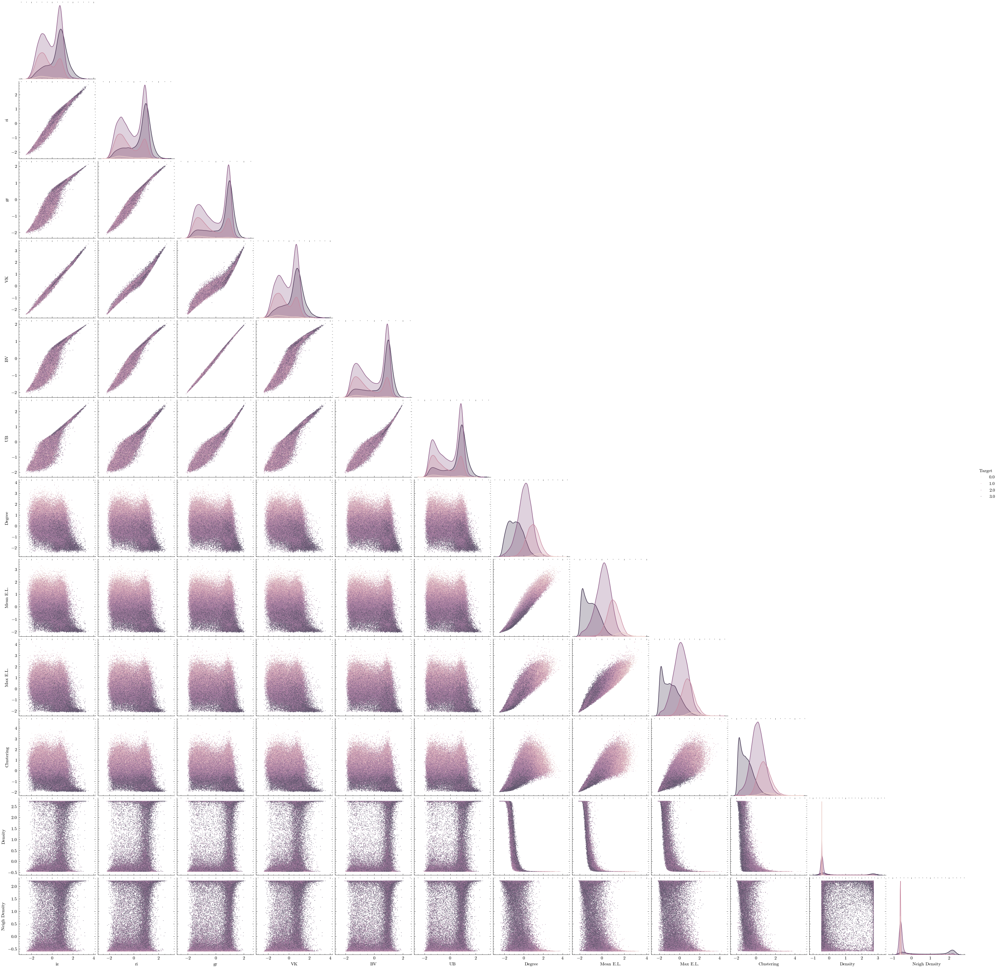

In [25]:
# pairplot of the data

sns.pairplot(data2, diag_kind='kde', plot_kws={'s':1}, hue='Target', corner=True)

In [26]:
# PCA and t-SNE

from sklearn.decomposition import PCA

pca = PCA(n_components=4) # we want to reduce the information to 4 dimensions that should represent each cosmic web environment

X_pca = pca.fit_transform(features)

In [27]:
print(pca.explained_variance_)
print(pca.explained_variance_ratio_)
pca.explained_variance_ratio_.cumsum()

[7.5901915  3.14386777 0.51245015 0.33003199]
[0.6325079  0.26198564 0.04270364 0.02750232]


array([0.6325079 , 0.89449354, 0.93719718, 0.9646995 ])

In [28]:
np.shape(X_pca)

data_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3', 'PC4'], index=features.index)
data_pca['Target'] = targets

data_pca

,PC1,PC2,PC3,PC4,Target
0,4.425923,3.102842,0.733871,0.505080,3.0
1,4.449789,3.140014,0.691202,0.519977,3.0
2,5.642154,1.967135,0.756205,0.617021,3.0
3,4.783245,1.956696,0.428120,0.863805,3.0
4,4.917472,2.054388,0.908344,0.568279,3.0
...,...,...,...,...,...
97228,2.727647,-1.321892,-0.041595,-1.144239,3.0
97229,1.044286,-0.758225,0.909774,-0.708783,2.0
97230,2.264052,0.217681,-1.184090,-0.840819,2.0
97231,2.627761,-0.820939,-0.905750,-0.860032,2.0


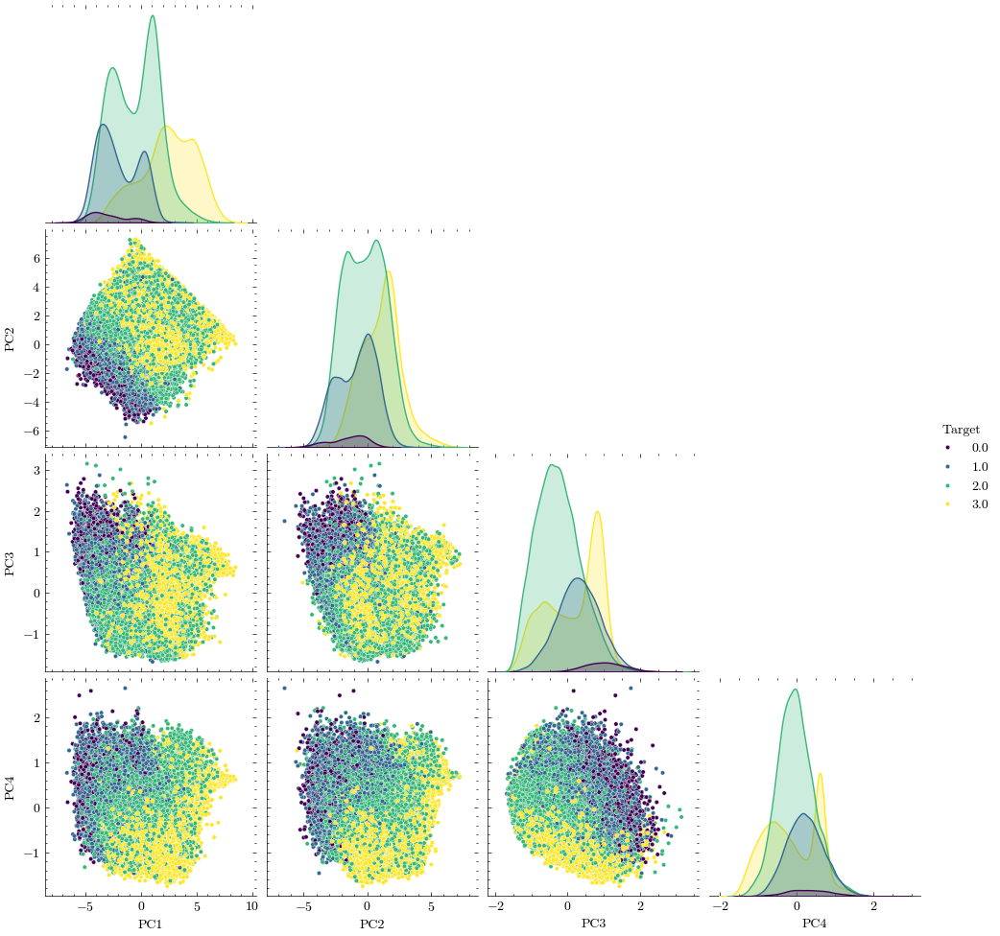

In [29]:
# PCA components as corner plot
import seaborn as sns
sns.pairplot(data_pca, hue='Target', diag_kind='kde', plot_kws={'s': 10}, palette='viridis', corner=True)


In [30]:
from sklearn.metrics import silhouette_score

silhouette_score =  silhouette_score(data_pca.iloc[:,:-1], data_pca.iloc[:,-1])


In [31]:
silhouette_score

0.02617156406427601

In [32]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y=X_pca[:,1], color=data['Target'])
# fig2 = px.scatter(x=X_pca[:,0], y=X_pca[:,2], color=data['Target'])
# fig3 = px.scatter(x=X_pca[:,0], y=X_pca[:,3], color=data['Target'])
# fig4 = px.scatter(x=X_pca[:,1], y=X_pca[:,2], color=data['Target'])
# fig5 = px.scatter(x=X_pca[:,1], y=X_pca[:,3], color=data['Target'])
# fig6 = px.scatter(x=X_pca[:,2], y=X_pca[:,3], color=data['Target'])

fig.update_layout(title='PCA P.C: 1,2')
# fig2.update_layout(title='PCA P.C: 1,3')
# fig3.update_layout(title='PCA P.C: 1,4')
# fig4.update_layout(title='PCA P.C: 2,3')
# fig5.update_layout(title='PCA P.C: 2,4')
# fig6.update_layout(title='PCA P.C: 3,4')

fig.show()


In [33]:
fig = px.scatter_3d(x=X_pca[:,0], y=X_pca[:,1], z=X_pca[:,2], color=data['Target'], opacity=1)
fig.update_traces(marker_size=2)
fig.update_layout(title='PCA 3D')
fig.show()

In [50]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(features)
tsne.kl_divergence_

2.218355178833008

In [ ]:
tsne

In [51]:
fig = px.scatter(x=X_tsne[:,0], y=X_tsne[:,1],color=data['Target'])
fig.update_layout(title='t-SNE')#, xaxis_title='t-SNE 1', yaxis_title='t-SNE 2', zaxis_title='t-SNE 3')

fig.show()

In [52]:
fig = px.scatter_3d(x=X_tsne[:,0], y=X_tsne[:,1], z= X_tsne[:,2],color=data['Target'])
fig.update_traces(marker_size=2)
fig.update_layout(title='t-SNE')#, xaxis_title='t-SNE 1', yaxis_title='t-SNE 2', zaxis_title='t-SNE 3')

fig.show()